In [1]:
# command mendownload helper.py
# Don't use it if you use windows os
!wget -N https://gist.githubusercontent.com/nmhlog/b42c7d574a3fcfcdc389c1dc2a363f4f/raw/b3882c91f816c7833f501e9190b1ba7d78c65ef9/helper.py

--2020-10-25 14:56:22--  https://gist.githubusercontent.com/nmhlog/b42c7d574a3fcfcdc389c1dc2a363f4f/raw/b3882c91f816c7833f501e9190b1ba7d78c65ef9/helper.py
Resolving gist.githubusercontent.com (gist.githubusercontent.com)... 151.101.0.133, 151.101.64.133, 151.101.128.133, ...
Connecting to gist.githubusercontent.com (gist.githubusercontent.com)|151.101.0.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 4495 (4.4K) [text/plain]
Saving to: ‘helper.py’

helper.py           100%[===================>]   4.39K  --.-KB/s    in 0s      

Last-modified header missing -- time-stamps turned off.
2020-10-25 14:56:22 (53.3 MB/s) - ‘helper.py’ saved [4495/4495]



In [2]:
# Initial package
import numpy as np
import matplotlib.pyplot as plt
from helper import *
from scipy import fftpack as fp
from skimage import io, color, util, filters, morphology


## 1. (Ilustrasi) Berikut adalah sebuah citra perta yang telah diretas oleh alien sehingga mengandung noise yang teratur. Kita bisa menghilangkan noise tersebut dengan filtering pada citra di domain frekuensi. Berikut adalah tahapan-tahapan yang harus dilakukan:

###a. Tampilkan citra tersebut pada domain frekuensi!

<function matplotlib.pyplot.imshow>

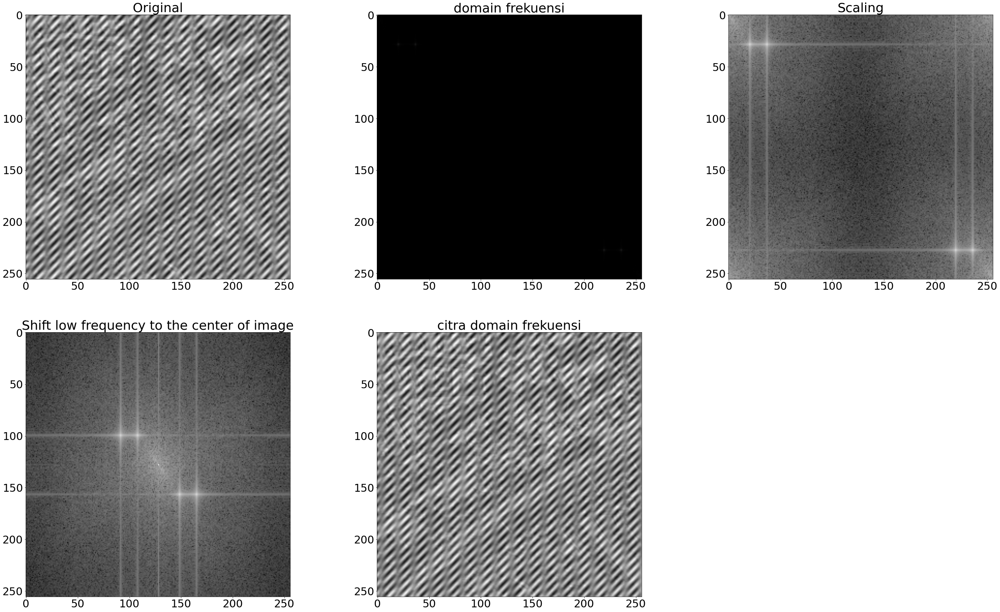

In [3]:
# Load image
map = color.rgb2gray(io.imread('https://raw.githubusercontent.com/nmhlog/SarimiIsidua/main/lab04/Tugas%20Lab%204%20-%20Images/Tugas%20Lab%204%20-%20Images/noisy_map.png'))
# Calculate DFT
# ft contains imaginary and real numbers
ft = fp.fft2(map)
# Calculate magnitude of imaginary and real numbers
ft_norm = abs(ft)
# Scale image
ft_scale = np.log(1 + ft_norm)
# Shift low frequency to the center of image
ft_shift = fp.fftshift(ft_scale)
# Calculate IDFT
# Can process only if imaginary and real numbers
# provided (Pay attention to what var is used here)
ift = fp.ifft2(ft).real
plt.figure(figsize=(50,30))
plt.rcParams['font.size'] = 30
plt.subplot(2,3,1), plt.imshow(map,cmap='gray'); plt.title('Original')
plt.subplot(2,3,2), plt.imshow(ft_norm,cmap='gray'); plt.title('domain frekuensi')
plt.subplot(2,3,3), plt.imshow(ft_scale,cmap='gray'); plt.title('Scaling')
plt.subplot(2,3,4), plt.imshow(ft_shift,cmap='gray'); plt.title('Shift low frequency to the center of image')
plt.subplot(2,3,5), plt.imshow(ift,cmap='gray'); plt.title('citra domain frekuensi')
plt.imshow

### b. Lakukan notch filtering untuk menghilangkan/melemahkan titik pada frekuensi dengan intensitas yang tinggi!

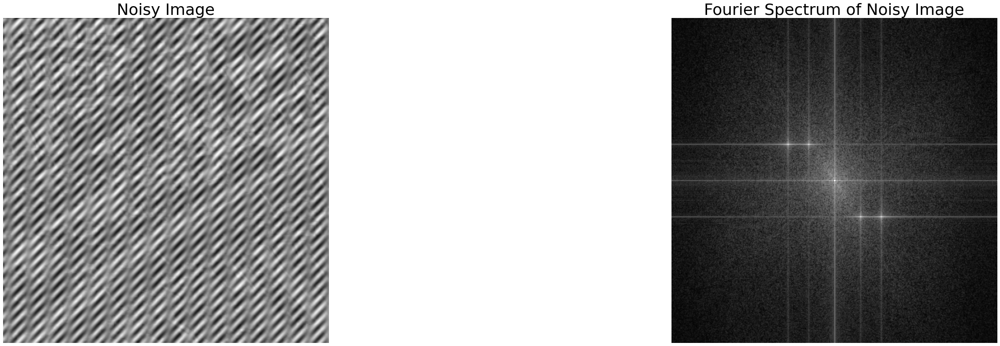

In [4]:

w, l = paddedsize(map.shape[0],map.shape[1])
# Calculate DFT
F = fp.fft2(util.img_as_float(map),(w,l))
# Scaling & Shifting for fourier spectrum display
Fc = fp.fftshift(F)
S1 = np.log(1+abs(Fc))
# Show image
plt.figure(figsize=(50,30))
plt.subplot(2,2,1); plt.imshow(ift, cmap='gray')
plt.title('Noisy Image'); plt.axis("off")
plt.subplot(2,2,2); plt.imshow(S1, cmap='gray')
plt.title('Fourier Spectrum of Noisy Image');
plt.axis("off")
plt.show()

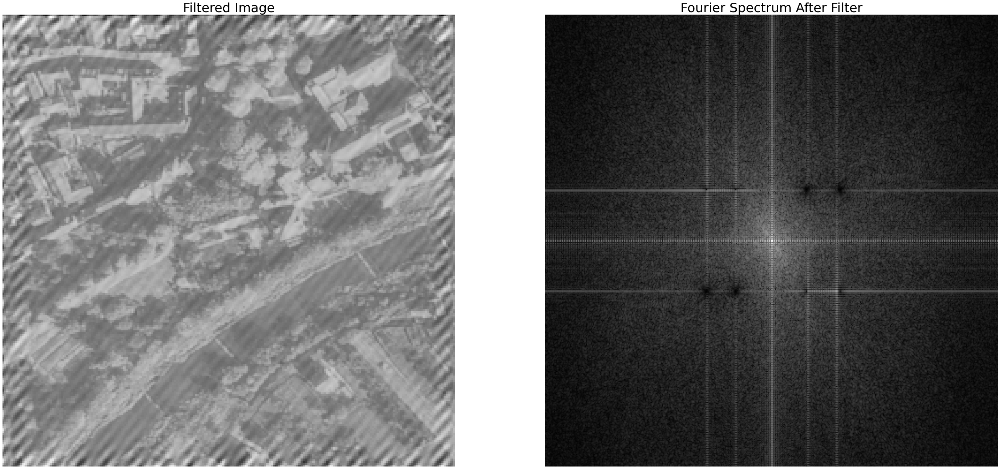

In [5]:
# Apply notch filter
# notch function is provided in helper.py
H1 = notch('btw', w, l, 10, -73, 455)
H2 = notch('btw', w, l, 10, -40, 455)
H3 = notch('btw', w, l, 10, 78, 58)
H4 = notch('btw', w, l, 10, 40, 58)
H5 = notch('btw', w, l, 10, 78, 455)
H6 = notch('btw', w, l, 10, 40, 455)
H7 = notch('btw', w, l, 10, -73, 58)
H8 = notch('btw', w, l, 10, -40, 58)
# Apply notch filter
FS_map = F*H1*H2*H3*H4*H5*H6*H7*H8
# Calculate IDFT for spatial domain transformation
F_map = fp.ifft2(FS_map).real
F_map = F_map[:map.shape[0],:map.shape[1]]
# Scaling & Shifting for fourier spectrum display
Fcf = fp.fftshift(FS_map)
S2 = np.log(1+abs(Fcf))
# Show image
plt.figure(figsize=(50,30))
plt.subplot(1,2,1); plt.imshow(F_map, cmap='gray')
plt.title('Filtered Image')
plt.axis("off")
plt.subplot(1,2,2); plt.imshow(S2, cmap='gray')
plt.title('Fourier Spectrum After Filter')
plt.axis("off")
plt.show()

c. Tampilkan perbandingan citra sebelum dan sesudah filtering pada domain spasial dan frekuensi!

(-0.5, 255.5, 255.5, -0.5)

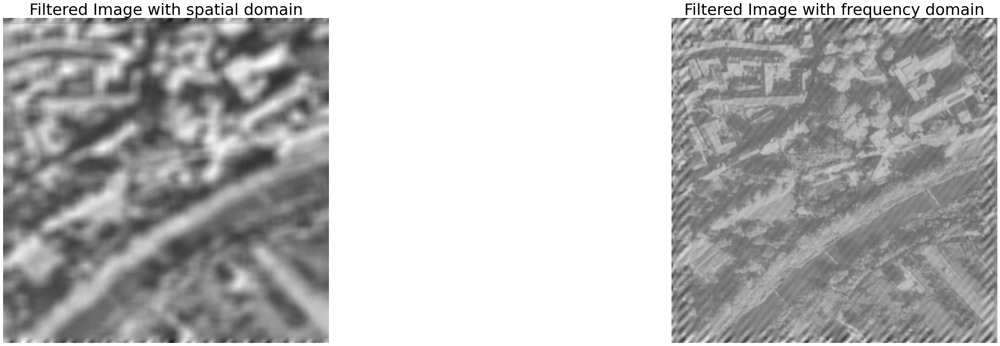

In [6]:
mean_Filter = filters.rank.mean(color.rgb2gray(map),selem = morphology.square(9))
plt.figure(figsize=(50,30))
plt.subplot(2,2,1); plt.imshow(mean_Filter, cmap='gray'); plt.title('Filtered Image with spatial domain');plt.axis("off")
plt.subplot(2,2,2); plt.imshow(F_map, cmap='gray'); plt.title('Filtered Image with frequency domain'); plt.axis("off")

#### Penjelasan 
notch filter adalah filter yang paling tepat pada noise citra ini, noise yang terdapat pada citra ialah noise repetitive spectral, yakni noise yang terlihat cerah (terlihat titik cerah dan memiliki intensitas tinggi) . untuk melemahkannya maka digunakan notch filtering. selain itu, filter di spatial domain memperhatikan nilai piksel dari citra,sedangkan filter frequency domain memperhatikan perubahan value piksel.  

## 2. Diberikan citra purple.png dengan ukuran 450x300 berikut ini:

- Sigma yang digunakan adalah 5% dari w, dengan nilai n default atau n=1


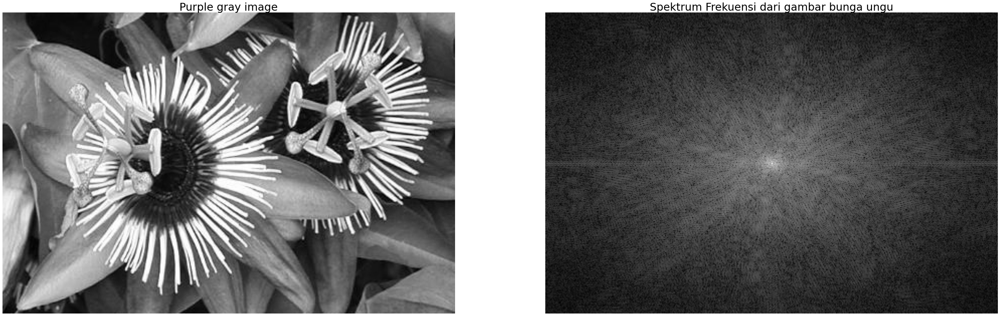

In [7]:
# Hosting image in Github
purple_path = "https://raw.githubusercontent.com/nmhlog/SarimiIsidua/main/lab04/Tugas%20Lab%204%20-%20Images/Tugas%20Lab%204%20-%20Images/purple.png"
# Membaca gambar
purple_img =  io.imread(purple_path)
# Mengubah gambar menjadi grayscale
gray_purple_img = color.rgb2gray(purple_img)
# Melakukan fft, scaling dan shifting
Scale_foriginal_gray_purple_img = np.log(1+ abs(fp.fft2(gray_purple_img)))
S_original_gray_purple_img = fp.fftshift(Scale_foriginal_gray_purple_img)
#Menampilkan gambar asli dengan spektrum frekeunsinya
fig, axs = plt.subplots(ncols=2,nrows=1,figsize=(50,20))
axs[0].imshow(gray_purple_img,cmap="gray");axs[0].set_title("Purple gray image",size=30);axs[0].axis("off")
axs[1].imshow(S_original_gray_purple_img,cmap="gray");axs[1].set_title("Spektrum Frekuensi dari gambar bunga ungu",size=30);axs[1].axis("off")
plt.show
# Melakukan paddedsize w,l untuk  Citra Gray
wgry, lgry = paddedsize(gray_purple_img.shape[0], gray_purple_img.shape[1])


## A. Lowpass Filter

- Sigma yang digunakan adalah 5% dari w



### 1. Terapkan Gaussian Lowpass Filter terhadap citra dan tampilkan hasilnya!


(-0.5, 899.5, 599.5, -0.5)

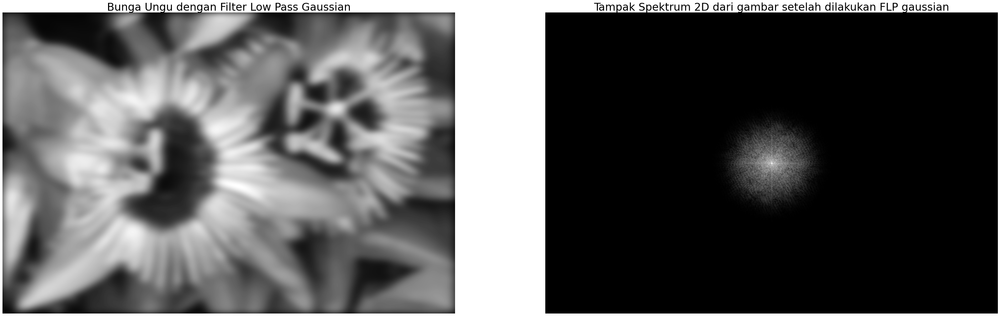

In [14]:

h_gaussian_gray = lpfilter('gaussian', wgry, lgry, 0.05 * wgry)
fil_gaussian_gray = fp.fft2(gray_purple_img,(wgry,lgry))
LPFS_gaussian_gray = h_gaussian_gray * fil_gaussian_gray
LPF_gaussian_gray = fp.ifft2(LPFS_gaussian_gray).real
LPF_gaussian_gray = LPF_gaussian_gray[:gray_purple_img.shape[0],:gray_purple_img.shape[1]]
F_gaussian_gray = fp.fftshift(LPFS_gaussian_gray)
S_LPF_gaussian_gray = np.log(1+abs(F_gaussian_gray))
fig, axs = plt.subplots(ncols=2,nrows=1,figsize=(50,20))
axs[0].imshow(LPF_gaussian_gray,cmap="gray");axs[0].set_title("Bunga Ungu dengan Filter Low Pass Gaussian",size=30);axs[0].axis("off")
axs[1].imshow(S_LPF_gaussian_gray,cmap="gray");axs[1].set_title("Tampak Spektrum 2D dari gambar setelah dilakukan FLP gaussian",size=30);axs[1].axis("off")

### 2. Terapkan Ideal Lowpass Filter terhadap citra dan tampilkan hasilnya!


(-0.5, 899.5, 599.5, -0.5)

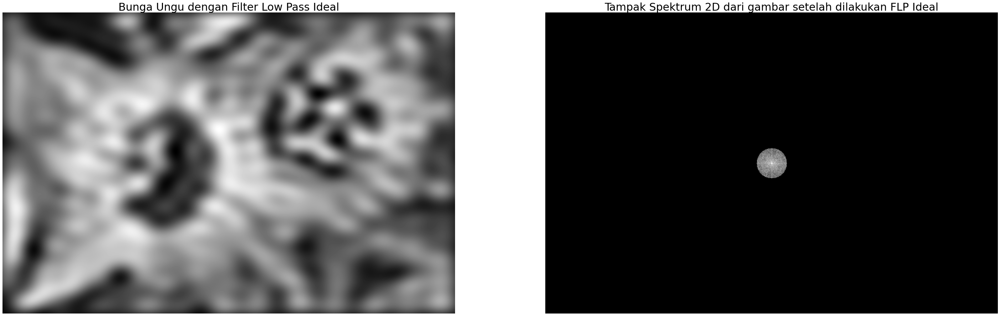

In [15]:
h_ideal_gray = lpfilter('ideal', wgry, lgry, 0.05 * wgry)
fil_ideal_gray = fp.fft2(gray_purple_img,(wgry,lgry))
LPFS_ideal_gray = h_ideal_gray * fil_ideal_gray
LPF_ideal_gray = fp.ifft2(LPFS_ideal_gray).real
LPF_ideal_gray = LPF_ideal_gray[:gray_purple_img.shape[0],:gray_purple_img.shape[1]]
F_ideal_gray = fp.fftshift(LPFS_ideal_gray)
S_LPF_ideal_gray = np.log(1+abs(F_ideal_gray))
fig, axs = plt.subplots(ncols=2,nrows=1,figsize=(50,20))
axs[0].imshow(LPF_ideal_gray,cmap="gray");axs[0].set_title("Bunga Ungu dengan Filter Low Pass Ideal",size =30);axs[0].axis("off")
axs[1].imshow(S_LPF_ideal_gray,cmap="gray");axs[1].set_title("Tampak Spektrum 2D dari gambar setelah dilakukan FLP Ideal",size=30);axs[1].axis("off")

### 3. Terapkan Butterworth Lowpass Filter terhadap citra dan tampilkan hasilnya!



(-0.5, 899.5, 599.5, -0.5)

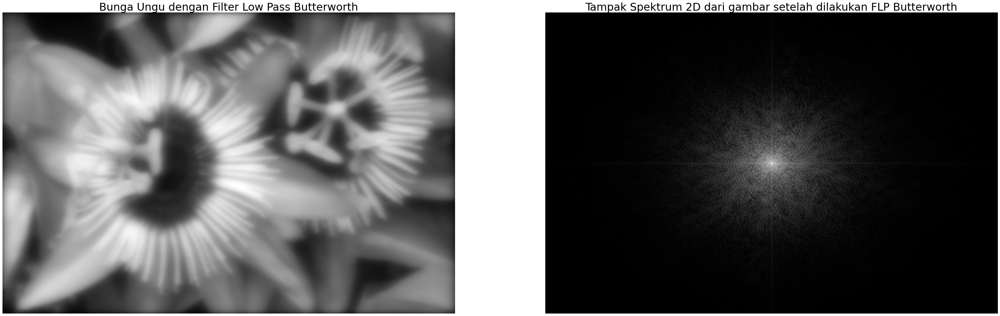

In [16]:
h_butterworth_gray = lpfilter('btw', wgry, lgry, 0.05 * wgry)
fil_butterworth_gray = fp.fft2(gray_purple_img,(wgry,lgry))
LPFS_butterworth_gray = h_butterworth_gray * fil_butterworth_gray
LPF_butterworth_gray = fp.ifft2(LPFS_butterworth_gray).real
LPF_butterworth_gray = LPF_butterworth_gray[:gray_purple_img.shape[0],:gray_purple_img.shape[1]]
F_butterworth_gray = fp.fftshift(LPFS_butterworth_gray)
S_LPF_butterworth_gray = np.log(1+abs(F_butterworth_gray))
fig, axs = plt.subplots(ncols=2,nrows=1,figsize=(50,20))
axs[0].imshow(LPF_butterworth_gray,cmap="gray");axs[0].set_title("Bunga Ungu dengan Filter Low Pass Butterworth",size=30);axs[0].axis("off")
axs[1].imshow(S_LPF_butterworth_gray,cmap="gray");axs[1].set_title("Tampak Spektrum 2D dari gambar setelah dilakukan FLP Butterworth",size=30);axs[1].axis("off")

### 4. Tampilkan empat citra pada domain spasial dan frekuensi: citra asli, Gaussian Lowpass Filter , Ideal Lowpass Filter , Butterworth Lowpass filter ! 



(-0.5, 899.5, 599.5, -0.5)

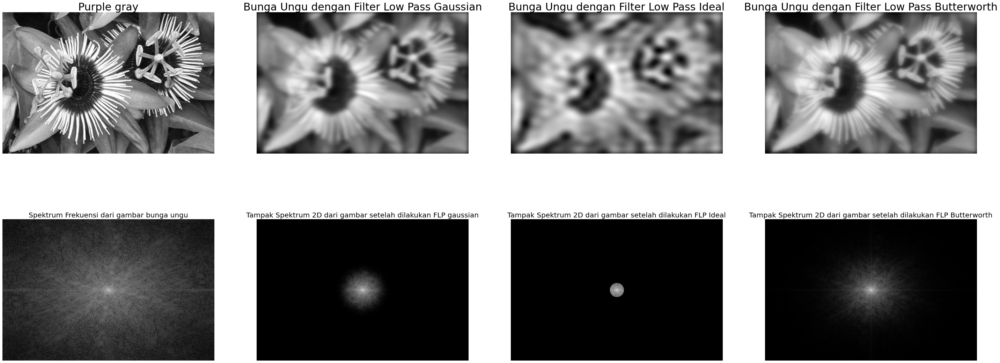

In [17]:
fig, axs = plt.subplots(ncols=4,nrows=2,figsize=(50,20))
# Menampilkan Gambar dari citra original dan hasil filter low pass
axs[0][0].imshow(gray_purple_img,cmap="gray");
axs[0][0].set_title("Purple gray",size=30);
axs[0][0].axis("off")

axs[0][1].imshow(LPF_gaussian_gray,cmap="gray");
axs[0][1].set_title("Bunga Ungu dengan Filter Low Pass Gaussian",size=30);
axs[0][1].axis("off")

axs[0][2].imshow(LPF_ideal_gray,cmap="gray");
axs[0][2].set_title("Bunga Ungu dengan Filter Low Pass Ideal",size =30);
axs[0][2].axis("off")

axs[0][3].imshow(LPF_butterworth_gray,cmap="gray");
axs[0][3].set_title("Bunga Ungu dengan Filter Low Pass Butterworth",size=30);
axs[0][3].axis("off")


# Menampilkan Gambar Citra Spektrum dari citra original dan hasil filter low pass
axs[1][0].imshow(S_original_gray_purple_img,cmap="gray");
axs[1][0].set_title("Spektrum Frekuensi dari gambar bunga ungu",size=20);
axs[1][0].axis("off");

axs[1][1].imshow(S_LPF_gaussian_gray,cmap="gray");
axs[1][1].set_title("Tampak Spektrum 2D dari gambar setelah dilakukan FLP gaussian",size=20);
axs[1][1].axis("off");

axs[1][2].imshow(S_LPF_ideal_gray,cmap="gray");
axs[1][2].set_title("Tampak Spektrum 2D dari gambar setelah dilakukan FLP Ideal",size=20);
axs[1][2].axis("off")

axs[1][3].imshow(S_LPF_butterworth_gray,cmap="gray");
axs[1][3].set_title("Tampak Spektrum 2D dari gambar setelah dilakukan FLP Butterworth",size=20);
axs[1][3].axis("off")


### Jelaskan perbedaan dari masing-masing citra tersebut!

- Jawaban :<br>
Pada gambar diatas kami menerapkan parameter yang sama untuk ke 3 filter dimana nilai D0 adalah 5% dari w dan derjat/n =1

Gambar diatas merupakan gambar hasil low pass filter pada spektrum frekuensi gambar bunga ungu. Terlihat bahwa ketiga gambar hasil low pass filter tersebut terjadi smooting atau bluring hal ini terjadi karena filter melewati frekuensi rendah atau perubahan pixel dalam gambar yang terhitung rendah dan menghilangkan frekuensi tinggi. dimana edge dan perubahan mendadak lainnya dalam intensitas dikaitkan dengan komponen frekuensi tinggi.

Pada gambar spektrum frekuensi citra dengan perlakukan Low pass filter terlihat bahwa nilai frekuensi yang dilewatkan berbentuk bulat dimana proses ini seperti proses pemotongan nilai citra asli dengan lingkaran bulat. hal ini dikarenakan proses pengkalian citra asli dengan fungsi transfer dari filter yang memiliki nilai 0 atau 1. dimana nilai satu merupakan lingkaran yang berwarna putih pada gambar dan 0 merupakan nilai diluar lingkaran tersebut sehingga nilai dihilangkan.

Secara kasat mata dapat terlihat pada gambar citra dengan perlakuan filter ideal kehilangan bentuk dari gambar aslinya dikarenakan citra keluaran hanya menampilkan frequensi rendah dalam luasan lingkaran sempurna yang kami ciptakan, berbeda dengan citra hasil filter butterworth dan gaussian dimana citra masukan keluar tidak bulat sempurna. hal ini dikarenakan citra masukan dikalian dengan fungsi transfer dari butterworth dan gaussian yang tidak langsung memberikan nilai 0 namun mengubah bentuk nilai tersebut yang akan dijelaskana secara ringkas dibawah ini.

Dalam kasus fungsi transfer gaussian,Fungsi transfer gaussian [np.exp(-(D**2)/(2*(D0**2)))], fungsi transfer tersebut yang mengatur besarnya kelandaian nilai sektrum citra hasil filter gaussian dimana faktor yang berperan penting adalah D0.

Dalam kasus fungsi transfer butterworth [1/(1 + (D/D0)**(2*n))] terdapat keunikan dimana nilai derajat/n yang lebih besar dapat meningkatkan lebar nilai titik pusat namun mengecilkan ukuran lingkaran keluaran dari hasil filter.

Rujukan :<br>
Gonzales, R C dan Wood, R E.2018.*Digital Image Processing Forth edition*. New york : Pearson. <br>

yang menarik dari perbedaan butterworth dan gaussian, dalam nilai D0 dan n yang sama gaussian memiliki ukuran nilai luas lingkaran spektrum yang lebih kecil dari butterworth. dan citra hasil dari filter low pass gaussian mesih blm menampakan bentuk tepinya secara jelas berbeda dengan butterworth yang tampak tepi lebih jelas.




## B. Highpass Filter


### 1. Terapkan Gaussian Highpass Filter terhadap citra dan tampilkan hasilnya!

(-0.5, 899.5, 599.5, -0.5)

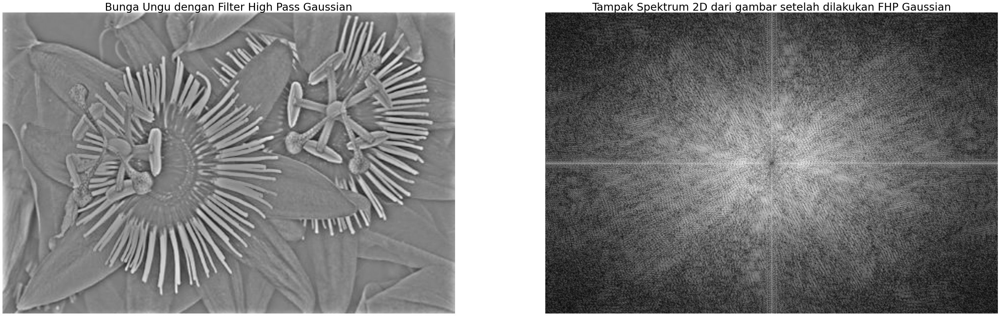

In [18]:
h_gaussian_gray = hpfilter('gaussian', wgry, lgry, 0.05* wgry)
fil_gaussian_gray = fp.fft2(gray_purple_img,(wgry,lgry))
HPFS_gaussian_gray = h_gaussian_gray * fil_gaussian_gray
HPF_gaussian_gray = fp.ifft2(HPFS_gaussian_gray).real
HPF_gaussian_gray = HPF_gaussian_gray[:gray_purple_img.shape[0],:gray_purple_img.shape[1]]
F_gaussian_gray = fp.fftshift(HPFS_gaussian_gray)
S_HPF_gaussian_gray = np.log(1+abs(F_gaussian_gray))
fig, axs = plt.subplots(ncols=2,nrows=1,figsize=(50,20))
axs[0].imshow(HPF_gaussian_gray,cmap="gray");axs[0].set_title("Bunga Ungu dengan Filter High Pass Gaussian",size=30);axs[0].axis("off")
axs[1].imshow(S_HPF_gaussian_gray,cmap="gray");axs[1].set_title("Tampak Spektrum 2D dari gambar setelah dilakukan FHP Gaussian",size=30);axs[1].axis("off")

### 2. Terapkan Ideal Highpass Filter terhadap citra dan tampilkan hasilnya!

(-0.5, 899.5, 599.5, -0.5)

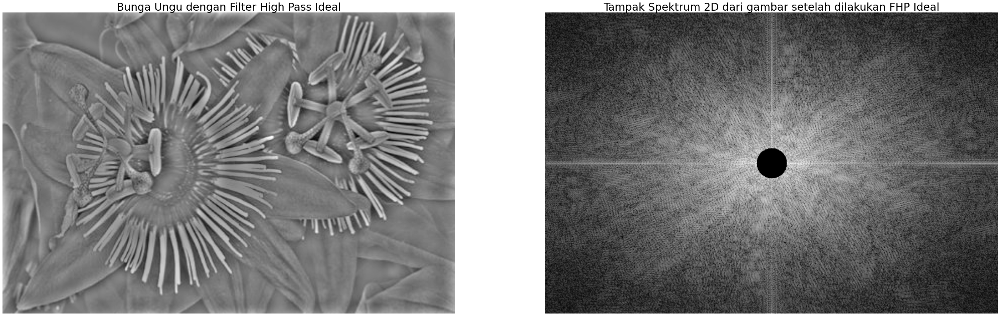

In [19]:
h_ideal_gray = hpfilter('ideal', wgry, lgry, 0.05 * wgry)
fil_ideal_gray = fp.fft2(gray_purple_img,(wgry,lgry))
HPFS_ideal_gray = h_ideal_gray * fil_ideal_gray
HPF_ideal_gray = fp.ifft2(HPFS_ideal_gray).real
HPF_ideal_gray = HPF_ideal_gray[:gray_purple_img.shape[0],:gray_purple_img.shape[1]]
F_ideal_gray = fp.fftshift(HPFS_ideal_gray)
S_HPF_ideal_gray = np.log(1+abs(F_ideal_gray))
fig, axs = plt.subplots(ncols=2,nrows=1,figsize=(50,20))
axs[0].imshow(HPF_ideal_gray,cmap="gray");axs[0].set_title("Bunga Ungu dengan Filter High Pass Ideal",size=30);axs[0].axis("off")
axs[1].imshow(S_HPF_ideal_gray,cmap="gray");axs[1].set_title("Tampak Spektrum 2D dari gambar setelah dilakukan FHP Ideal",size=30);axs[1].axis("off")

### 3. Terapkan Butterworth Highpass Filter terhadap citra dan tampilkan hasilnya!


(-0.5, 899.5, 599.5, -0.5)

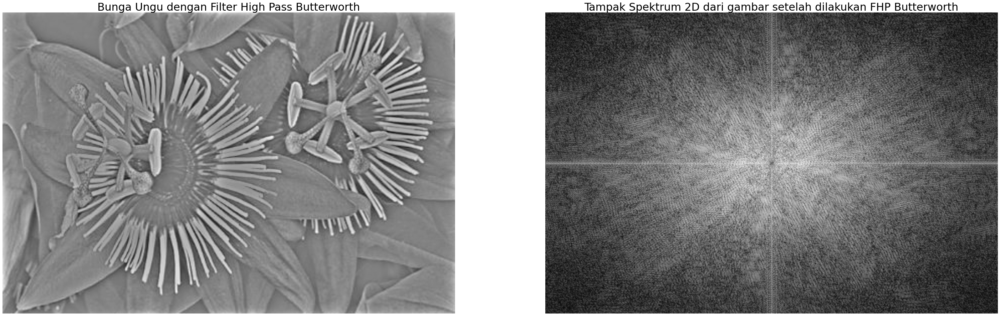

In [20]:
h_butterworth_gray = hpfilter('btw', wgry, lgry, 0.05 * wgry)
fil_butterworth_gray = fp.fft2(gray_purple_img,(wgry,lgry))
HPFS_butterworth_gray = h_butterworth_gray * fil_butterworth_gray
HPF_butterworth_gray = fp.ifft2(HPFS_butterworth_gray).real
HPF_butterworth_gray = HPF_butterworth_gray[:gray_purple_img.shape[0],:gray_purple_img.shape[1]]
F_butterworth_gray = fp.fftshift(HPFS_butterworth_gray)
S_HPF_butterworth_gray = np.log(1+abs(F_butterworth_gray))
fig, axs = plt.subplots(ncols=2,nrows=1,figsize=(50,20))
axs[0].imshow(HPF_butterworth_gray,cmap="gray");axs[0].set_title("Bunga Ungu dengan Filter High Pass Butterworth",size=30);axs[0].axis("off")
axs[1].imshow(S_HPF_butterworth_gray,cmap="gray");axs[1].set_title("Tampak Spektrum 2D dari gambar setelah dilakukan FHP Butterworth",size=30);axs[1].axis("off")

### 4. Tampilkan empat citra pada domain spasial dan frekuensi: citra asli, Gaussian Highpass Filter , Ideal Highpass Filter , Butterworth Highpass filter ! 

(-0.5, 899.5, 599.5, -0.5)

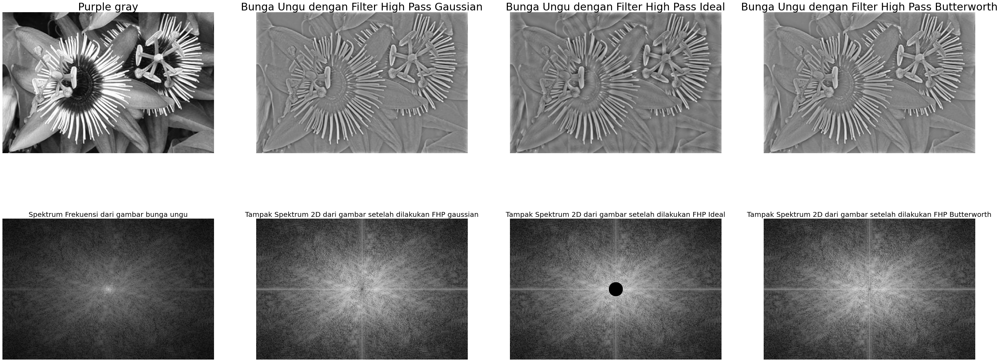

In [21]:
fig, axs = plt.subplots(ncols=4,nrows=2,figsize=(50,20))
# Menampilkan Gambar dari citra original dan hasil filter high pass
axs[0][0].imshow(gray_purple_img,cmap="gray");
axs[0][0].set_title("Purple gray",size=30);
axs[0][0].axis("off")

axs[0][1].imshow(HPF_gaussian_gray,cmap="gray");
axs[0][1].set_title("Bunga Ungu dengan Filter High Pass Gaussian",size=30);
axs[0][1].axis("off")

axs[0][2].imshow(HPF_ideal_gray,cmap="gray");
axs[0][2].set_title("Bunga Ungu dengan Filter High Pass Ideal",size =30);
axs[0][2].axis("off")

axs[0][3].imshow(HPF_butterworth_gray,cmap="gray");
axs[0][3].set_title("Bunga Ungu dengan Filter High Pass Butterworth",size=30);
axs[0][3].axis("off")


# Menampilkan Gambar Citra Spektrum dari citra original dan hasil filter high pass
axs[1][0].imshow(S_original_gray_purple_img,cmap="gray");
axs[1][0].set_title("Spektrum Frekuensi dari gambar bunga ungu",size=20);
axs[1][0].axis("off");

axs[1][1].imshow(S_HPF_gaussian_gray,cmap="gray");
axs[1][1].set_title("Tampak Spektrum 2D dari gambar setelah dilakukan FHP gaussian",size=20);
axs[1][1].axis("off");

axs[1][2].imshow(S_HPF_ideal_gray,cmap="gray");
axs[1][2].set_title("Tampak Spektrum 2D dari gambar setelah dilakukan FHP Ideal",size=20);
axs[1][2].axis("off")

axs[1][3].imshow(S_HPF_butterworth_gray,cmap="gray");
axs[1][3].set_title("Tampak Spektrum 2D dari gambar setelah dilakukan FHP Butterworth",size=20);
axs[1][3].axis("off")


### Jelaskan perbedaan dari masing-masing citra tersebut!
- jawaban :<br>
Pada gambar diatas kami menerapkan parameter yang sama untuk ke 3 filter dimana nilai D0 adalah 5% dari w dan derjat/n =1.

Secara konsep Filter high pass berkerja seperti mengurangi nilai spektrum frekeunsi asli dengan nilai keluaran citra low pass. dimana fungsi transfernya merupakan F(high pass filter) = 1- F(low pass filter).

Filter high pass merupakan kebalikan dari filter low pass dimana melewatkan frekeunsi tinggi dan menghilangkan atau mengurai nilai frekeunsi rendahnya. Bila dikaji lebih jauh terlihat bahwa gambar yang ditampilkan merupakan countur/ bentuk, edge yang tersisa dari gambar tersebut.

filter ideal, menghilangkan frekeunsi rendah dengan cara memberikan nilai nol pada lingkaran tengah yang telah kami buat, dan sedangkan nilai 1 pada luar lingkaran tersebut.

namun yang menarik dari ketiga filter tersebut adalah membandingkan antara butterworth dan gaussian, terlihat bahwa nilai titik pusat pada spektrum frekeunsi high pass guassian lebih tipis dari gambar keluaran high pass butterworth.

Bila kita mengupas gambar lebih jauh. gambar dengan filter gaussian dan butterworth memiliki warna yang dasar yang konstan. Berbeda dengan hasil filter pass ideal, dimana gambar seperti terlihat adanya gradasi putih dan hitam pada seluruh gambar. sebagai contoh : bila kita telaah lebih jauh lingkaran bungan pada filter ideal terdapat gradasi warna hitam dan putih, perubahan kontur bentuk dan warna terlihat lebih jelas pada filter high pass butterworth, pada filter gaussian perubahan warna lebih berlihat keabu-abuan.

karenanya sepulasi kami adalah:
high pass ideal hanya menghilangkan frekeunsi rendah namun ketajaman dari bentuk dan warna tidak beraturan karena tidak diperhatikan dengan jelas nilai dari nilai pixelnya. Disisi lain high pass dengan gaussian dan butterworth menghasilkan gambar dengan awrna yang konstan namun perubahan warna lebih baik pada sisi filter butterworth.